# ***Proyecto final - Reconocimiento de lenguaje de señas***
**UNIVERSIDAD INDUSTRIAL DE SANTANDER - UIS FACULTAD DE INGENIERÍAS FÍSICOMECÁNICAS**

**ESCUELA DE INGENIERÍA DE SISTEMAS E INFORMÁTICA: INGENIERÍA DE SISTEMAS**

Prof. Gustavo Adolfo Garzón Villamizar

___

**Estudiantes:**

* Angélica María Sanabria Flórez - 2205564

* Julian Andrés Jaramillo Benavides - 2215510
___
# ***Dataset***

___
[American Sign Language recognition](https://www.kaggle.com/datasets/rahulmakwana/american-sign-language-recognition):Este proyecto utiliza el dataset "American Sign Language Recognition" disponible en Kaggle, el cual se basa en el conjunto de datos MNIST de lenguaje de señas. El objetivo es entrenar un modelo para reconocer gestos del lenguaje de señas americano (ASL).
___
**Composición del conjunto de datos:**

El dataset está dividido en tres subconjuntos:

* **Entrenamiento:** Contiene 48,282 imágenes.
* **Validación:** Contiene 12,070 imágenes.
* **Prueba:** Contiene 8,000 imágenes.

En total, el dataset incluye 68,352 imágenes distribuidas en 40 clases diferentes (gestos de ASL), con una distribución relativamente balanceada entre las clases.

**Características de la imagen:**

* **Tamaño:** Son imágenes cuadradas de 64x64 píxeles.
* **Modo de color:** Originalmente son imágenes en escala de grises. Para el entrenamiento con modelos preentrenados como EfficientNetB0 o MobileNetV3, se convierten a RGB (3 canales) durante el preprocesamiento.
* **Preprocesamiento:** Las imágenes se normalizan dividiendo los valores de los píxeles por 255.0 para escalarlos al rango [0, 1].
* **En tiempo real (Webcam):** Para la traducción en tiempo real, las imágenes de la webcam se convierten a escala de grises, se les aplica un desenfoque Gaussiano, se binarizan usando Otsu, se detectan contornos para aislar la mano, se recorta y se rellena para obtener una imagen cuadrada antes de redimensionarla a 64x64 y normalizarla.

# American Sign Language Gesture Translator
Este cuaderno crea un pipeline completo para entrenar un modelo de IA que reconoce gestos de lenguaje de señas americano (ASL) usando el dataset descrito en *The Sign Language MNIST dataset*. También incluye una utilidad para traducir gestos en tiempo real con una webcam.

# ***Instalación de dependencias***

In [ ]:
%pip install -q \
    absl-py==2.3.1 \
    astunparse==1.6.3 \
    certifi==2025.11.12 \
    charset-normalizer==3.4.4 \
    colorama==0.4.6 \
    contourpy==1.3.3 \
    cycler==0.12.1 \
    flatbuffers==25.9.23 \
    fonttools==4.60.1 \
    gast==0.6.0 \
    google-pasta==0.2.0 \
    grpcio==1.76.0 \
    h5py==3.15.1 \
    idna==3.11 \
    joblib==1.5.2 \
    kagglehub==0.3.13 \
    keras==3.12.0 \
    kiwisolver==1.4.9 \
    libclang==18.1.1 \
    Markdown==3.10 \
    markdown-it-py==4.0.0 \
    MarkupSafe==3.0.3 \
    matplotlib==3.10.7 \
    mdurl==0.1.2 \
    ml_dtypes==0.5.3 \
    namex==0.1.0 \
    numpy==2.2.6 \
    opencv-python==4.12.0.88 \
    opt_einsum==3.4.0 \
    optree==0.18.0 \
    packaging==25.0 \
    pandas==2.3.3 \
    pillow==12.0.0 \
    protobuf==6.33.1 \
    Pygments==2.19.2 \
    pyparsing==3.2.5 \
    python-dateutil==2.9.0.post0 \
    pytz==2025.2 \
    PyYAML==6.0.3 \
    requests==2.32.5 \
    rich==14.2.0 \
    scikit-learn==1.7.2 \
    scipy==1.16.3 \
    setuptools==80.9.0 \
    six==1.17.0 \
    tensorboard==2.20.0 \
    tensorboard-data-server==0.7.2 \
    tensorflow==2.20.0 \
    termcolor==3.2.0 \
    threadpoolctl==3.6.0 \
    tqdm==4.67.1 \
    typing_extensions==4.15.0 \
    tzdata==2025.2 \
    urllib3==2.5.0 \
    Werkzeug==3.1.3 \
    wheel==0.45.1 \
    wrapt==2.0.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.2/91.2 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 159.4/159.4 kB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 53.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 152.8 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 124.3 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 408.2/408.2 kB 38.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 137.2 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 147.8 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 323.2/323.2 kB 28.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.7/64.7 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━

# ***Configuración Inicial y Definición de Parámetros***

In [ ]:
import json
from pathlib import Path
from typing import List, Tuple

import kagglehub
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.applications import efficientnet, mobilenet_v3

from tensorflow.keras.utils import register_keras_serializable

@register_keras_serializable(name="cast_to_float")
def cast_to_float(x: tf.Tensor) -> tf.Tensor:
    return tf.cast(x, tf.float32)

@register_keras_serializable(name="grayscale_to_rgb")
def grayscale_to_rgb(x: tf.Tensor) -> tf.Tensor:
    return tf.image.grayscale_to_rgb(x)

@register_keras_serializable(name="mobilenet_v3_preprocess")
def mobilenet_v3_preprocess(x: tf.Tensor) -> tf.Tensor:
    return mobilenet_v3.preprocess_input(x)

@register_keras_serializable(name="efficientnet_b0_preprocess")
def efficientnet_b0_preprocess(x: tf.Tensor) -> tf.Tensor:
    return efficientnet.preprocess_input(x)


!nvidia-smi
print("GPUs:", tf.config.list_physical_devices("GPU"))

IMAGE_SIZE: Tuple[int, int] = (64, 64)
BATCH_SIZE = 256
EPOCHS = 10
VALIDATION_SPLIT = 0.2
MODEL_TYPE = "efficientnet_b0"  # "cnn", "mobilenet_v3" o "efficientnet_b0"
DATASET_ID = "rahulmakwana/american-sign-language-recognition"
MODEL_DIR = Path("models")
MODEL_NAME = "asl_sign_classifier.keras"
LABELS_FILE = "asl_sign_labels.json"


Tue Nov 18 22:17:06 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   47C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# ***Descarga del dataset***

In [ ]:
dataset_root = Path(kagglehub.dataset_download(DATASET_ID))
dataset_root

Using Colab cache for faster access to the 'american-sign-language-recognition' dataset.


PosixPath('/kaggle/input/american-sign-language-recognition')

# ***Construcción de los `tf.data.Dataset`***

In [ ]:
def build_datasets(dataset_root: Path):
    train_dir = dataset_root / "training_set"
    test_dir = dataset_root / "test_set"

    train_ds = tf.keras.utils.image_dataset_from_directory(
        train_dir,
        validation_split=VALIDATION_SPLIT,
        subset="training",
        seed=42,
        color_mode="grayscale",
        image_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
    )

    val_ds = tf.keras.utils.image_dataset_from_directory(
        train_dir,
        validation_split=VALIDATION_SPLIT,
        subset="validation",
        seed=42,
        color_mode="grayscale",
        image_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
    )

    test_ds = tf.keras.utils.image_dataset_from_directory(
        test_dir,
        color_mode="grayscale",
        image_size=IMAGE_SIZE,
        shuffle=False,
        batch_size=BATCH_SIZE,
    )

    autotune = tf.data.AUTOTUNE

    def prepare(ds: tf.data.Dataset) -> tf.data.Dataset:
        return (
            ds.prefetch(autotune)
            .cache()
            .map(lambda x, y: (tf.cast(x, tf.float32), y), num_parallel_calls=autotune)
        )

    return prepare(train_ds), prepare(val_ds), prepare(test_ds), train_ds.class_names

In [ ]:
train_ds, val_ds, test_ds, class_names = build_datasets(dataset_root)
len(class_names)

# Calculate and print the number of images per class in the validation dataset
num_classes = len(class_names)
val_counts = np.zeros(num_classes, dtype=int)

for batch_images, batch_labels in val_ds:
    labels = batch_labels.numpy()              # Tensor -> numpy
    val_counts += np.bincount(labels, minlength=num_classes)

print("=== Imágenes por clase en VALIDACIÓN ===")
for i, (name, count) in enumerate(zip(class_names, val_counts)):
    print(f"{i:2d}  {name:15s}: {count}")

print("\nTotal imágenes en validación:", val_counts.sum())


# Calculate and print the number of images per class in the train dataset

num_classes = len(class_names)
counts = np.zeros(num_classes, dtype=int)

for batch_images, batch_labels in train_ds:
    labels = batch_labels.numpy()              # Tensor -> numpy
    counts += np.bincount(labels, minlength=num_classes)

print("=== Imágenes por clase en TRAIN ===")
for i, (name, count) in enumerate(zip(class_names, counts)):
    print(f"{i:2d}  {name:15s}: {count}")

print("\nTotal imágenes en train:", counts.sum())


Found 60352 files belonging to 40 classes.
Using 48282 files for training.
Found 60352 files belonging to 40 classes.
Using 12070 files for validation.
Found 8000 files belonging to 40 classes.
=== Imágenes por clase en VALIDACIÓN ===
 0  1              : 289
 1  10             : 307
 2  2              : 267
 3  3              : 306
 4  4              : 303
 5  5              : 292
 6  6              : 290
 7  7              : 350
 8  8              : 302
 9  9              : 299
10  A              : 304
11  B              : 311
12  C              : 301
13  D              : 341
14  E              : 274
15  F              : 330
16  G              : 298
17  H              : 346
18  I              : 301
19  J              : 319
20  K              : 268
21  L              : 273
22  M              : 278
23  N              : 292
24  O              : 314
25  P              : 310
26  Q              : 298
27  R              : 300
28  S              : 302
29  T              : 295
30  U          

# ***Arquitectura del modelo***

In [ ]:
def build_model(num_classes: int, model_type: str = MODEL_TYPE) -> tf.keras.Model:
    """Create a classifier using either the custom CNN or a pretrained backbone."""

    pretrained_specs = {
        "mobilenet_v3": {
            "builder": tf.keras.applications.MobileNetV3Small,
            "preprocess": mobilenet_v3_preprocess,
            "target_size": (96, 96),
        },
        "efficientnet_b0": {
            "builder": tf.keras.applications.EfficientNetB0,
            "preprocess": efficientnet_b0_preprocess,
            "target_size": (128, 128),
        },
    }

    inputs = layers.Input(shape=(*IMAGE_SIZE, 1))
    data_augmentation = tf.keras.Sequential(
        [
            layers.RandomRotation(0.3),
            layers.RandomTranslation(0.3, 0.25),
            layers.RandomZoom(0.3),
        ],
        name="augmentation",
    )

    x = data_augmentation(inputs)

    if model_type == "cnn":
        x = layers.Rescaling(1.0 / 255)(x)
        for filters in (32, 64, 128):
            x = layers.Conv2D(filters, kernel_size=3, padding="same", activation=None)(x)
            x = layers.BatchNormalization()(x)
            x = layers.Activation("relu")(x)
            x = layers.MaxPooling2D(pool_size=2)(x)
            x = layers.Dropout(0.2)(x)

        x = layers.Flatten()(x)
        x = layers.Dense(256, activation="relu")(x)
        x = layers.Dropout(0.4)(x)
        outputs = layers.Dense(num_classes, activation="softmax")(x)
    elif model_type in pretrained_specs:
        spec = pretrained_specs[model_type]
        height, width = spec["target_size"]

        x = layers.Lambda(cast_to_float, name="cast_to_float")(x)
        x = layers.Resizing(height, width)(x)
        x = layers.Lambda(grayscale_to_rgb, name="grayscale_to_rgb")(x)
        x = layers.Lambda(spec["preprocess"], name=f"{model_type}_preprocess")(x)

        base_model = spec["builder"](
            include_top=False,
            weights="imagenet",
            input_shape=(height, width, 3),
        )
        base_model.trainable = False

        x = base_model(x, training=False)
        x = layers.GlobalAveragePooling2D()(x)
        x = layers.Dropout(0.3)(x)
        outputs = layers.Dense(num_classes, activation="softmax")(x)
    else:
        raise ValueError(
            f"Modelo '{model_type}' no soportado. Usa 'cnn', 'mobilenet_v3' o 'efficientnet_b0'."
        )

    model = tf.keras.Model(inputs, outputs, name=f"asl_sign_{model_type}")
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"],
    )
    return model


# ***Construcción y Entrenamiento del Modelo***

In [ ]:
MODEL_DIR.mkdir(parents=True, exist_ok=True)
model = build_model(num_classes=len(class_names))
model.summary()

callbacks = [
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor="val_accuracy", patience=9, factor=0.5, verbose=1
    ),
    tf.keras.callbacks.EarlyStopping(
        monitor="val_accuracy", patience=80, restore_best_weights=True, verbose=1
    ),
    tf.keras.callbacks.ModelCheckpoint(
        filepath=MODEL_DIR / MODEL_NAME,
        monitor="val_accuracy",
        save_best_only=True,
        save_weights_only=False,
        verbose=1,
    ),
]

history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    callbacks=callbacks

)

history.history

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "asl_sign_efficientnet_b0"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ augmentation (Sequential)       │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cast_to_float (Lambda)          │ (None, 64, 64, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resizing (Resizing)             │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ grayscale_to_rgb (Lambda)       │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnet_b0_preprocess      │ (None, 128, 128, 3)    │             0 │
│ (Lambda)                        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 4, 4, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 40)             │        51,240 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,100,811 (15.64 MB)

 Trainable params: 51,240 (200.16 KB)

 Non-trainable params: 4,049,571 (15.45 MB)

Epoch 1/10
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - accuracy: 0.3499 - loss: 2.5654
Epoch 1: val_accuracy improved from None to 0.74234, saving model to models/asl_sign_classifier.keras
189/189 ━━━━━━━━━━━━━━━━━━━━ 57s 228ms/step - accuracy: 0.5079 - loss: 1.9530 - val_accuracy: 0.7423 - val_loss: 0.8510 - learning_rate: 0.0010
Epoch 2/10
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - accuracy: 0.6849 - loss: 1.2055
Epoch 2: val_accuracy improved from 0.74234 to 0.80613, saving model to models/asl_sign_classifier.keras
189/189 ━━━━━━━━━━━━━━━━━━━━ 40s 209ms/step - accuracy: 0.7010 - loss: 1.1345 - val_accuracy: 0.8061 - val_loss: 0.5806 - learning_rate: 0.0010
Epoch 3/10
189/189 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - accuracy: 0.7317 - loss: 0.9788
Epoch 3: val_accuracy improved from 0.80613 to 0.82527, saving model to models/asl_sign_classifier.keras
189/189 ━━━━━━━━━━━━━━━━━━━━ 40s 210ms/step - accuracy: 0.7401 - loss: 0.9450 - val_accuracy: 0.8253 - val_loss: 0.5153 - learning_rate:

{'accuracy': [0.5078911185264587,
  0.700985848903656,
  0.740089476108551,
  0.7685679793357849,
  0.7793380618095398,
  0.7904602289199829,
  0.7974193096160889,
  0.8051654696464539,
  0.8104055523872375,
  0.8145064115524292],
 'loss': [1.953011393547058,
  1.1344765424728394,
  0.9450192451477051,
  0.8362436294555664,
  0.7768465876579285,
  0.7265099287033081,
  0.6993809938430786,
  0.6698848009109497,
  0.6471779942512512,
  0.6306228041648865],
 'val_accuracy': [0.7423363924026489,
  0.8061308860778809,
  0.8252692818641663,
  0.8564208745956421,
  0.8570008277893066,
  0.8742336630821228,
  0.8719967007637024,
  0.8953604102134705,
  0.90082848072052,
  0.9025683403015137],
 'val_loss': [0.85099196434021,
  0.5805643200874329,
  0.5152975916862488,
  0.42731085419654846,
  0.4305172860622406,
  0.38748806715011597,
  0.37211182713508606,
  0.31956765055656433,
  0.31525173783302307,
  0.3138488531112671],
 'learning_rate': [0.0010000000474974513,
  0.0010000000474974513,
  0

# ***Visualización de Curvas de entrenamiento***

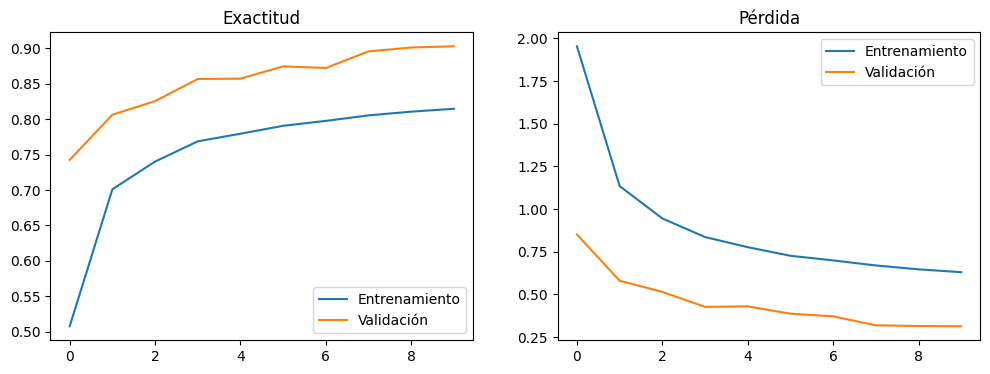

In [ ]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history["accuracy"], label="Entrenamiento")
plt.plot(history.history["val_accuracy"], label="Validación")
plt.title("Exactitud")
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history.history["loss"], label="Entrenamiento")
plt.plot(history.history["val_loss"], label="Validación")
plt.title("Pérdida")
plt.legend()
plt.show()

# ***Evaluación del Modelo en el Conjunto de Prueba***

In [ ]:
test_loss, test_acc = model.evaluate(test_ds)
print(f"Test accuracy: {test_acc:.3f}")
print(f"Test loss: {test_loss:.3f}")

32/32 ━━━━━━━━━━━━━━━━━━━━ 19s 592ms/step - accuracy: 0.9141 - loss: 0.3397
Test accuracy: 0.914
Test loss: 0.340


=== Métricas por clase ===
Clase           Soporte  Precisión     Recall         F1
1                   200      1.000      1.000      1.000
10                  200      1.000      0.960      0.980
2                   200      0.962      1.000      0.980
3                   200      1.000      0.675      0.806
4                   200      0.975      0.980      0.978
5                   200      1.000      1.000      1.000
6                   200      0.943      1.000      0.971
7                   200      1.000      0.910      0.953
8                   200      0.916      0.980      0.947
9                   200      1.000      0.985      0.992
A                   200      0.976      1.000      0.988
B                   200      1.000      1.000      1.000
C                   200      1.000      1.000      1.000
D                   200      0.669      1.000      0.802
E                   200      0.694      0.860      0.768
F                   200      0.868      0.990      0.925
G   

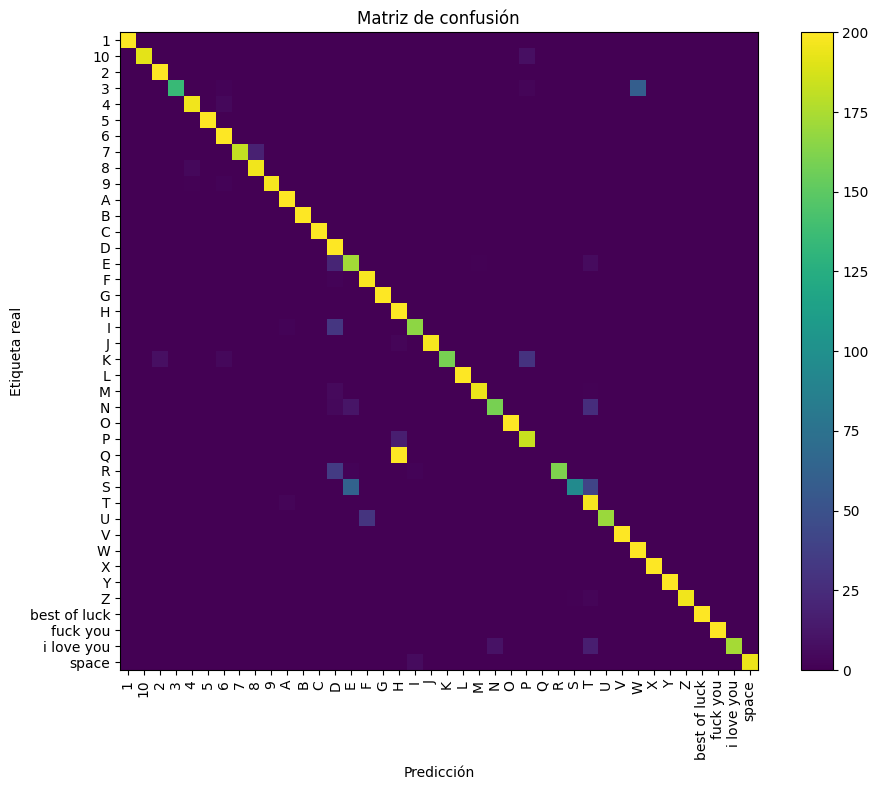

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# ================== 1. Recolectar y_true e y_pred ==================

y_true = []
y_pred = []

for batch_images, batch_labels in test_ds:
    probs = model.predict(batch_images, verbose=0)
    y_true.extend(batch_labels.numpy())
    y_pred.extend(np.argmax(probs, axis=1))

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# ================== 2. Matriz de confusión ==================

num_classes = len(class_names)

cm = tf.math.confusion_matrix(
    y_true, y_pred, num_classes=num_classes
).numpy()

# ================== 3. Métricas por clase ==================

precision = np.zeros(num_classes)
recall = np.zeros(num_classes)
f1 = np.zeros(num_classes)
support = cm.sum(axis=1)  # nº de ejemplos por clase

for i in range(num_classes):
    tp = cm[i, i]
    fp = cm[:, i].sum() - tp
    fn = cm[i, :].sum() - tp

    precision[i] = tp / (tp + fp) if (tp + fp) > 0 else 0.0
    recall[i]    = tp / (tp + fn) if (tp + fn) > 0 else 0.0
    f1[i]        = (
        2 * precision[i] * recall[i] / (precision[i] + recall[i])
        if (precision[i] + recall[i]) > 0
        else 0.0
    )

macro_f1 = f1.mean()
weighted_f1 = (f1 * support / support.sum()).sum()

print("=== Métricas por clase ===")
print(f"{'Clase':15s} {'Soporte':>7s} {'Precisión':>10s} {'Recall':>10s} {'F1':>10s}")
for name, sup, p, r, f in zip(class_names, support, precision, recall, f1):
    print(f"{name:15s} {int(sup):7d} {p:10.3f} {r:10.3f} {f:10.3f}")

print("\nF1 macro:    {:.3f}".format(macro_f1))
print("F1 weighted: {:.3f}".format(weighted_f1))

# ================== 4. Matriz de confusión visual ==================

fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(cm, interpolation="nearest")
plt.colorbar(im, ax=ax)

ax.set_xticks(range(num_classes))
ax.set_yticks(range(num_classes))
ax.set_xticklabels(class_names, rotation=90)
ax.set_yticklabels(class_names)
ax.set_xlabel("Predicción")
ax.set_ylabel("Etiqueta real")
ax.set_title("Matriz de confusión")
plt.tight_layout()
plt.show()

# ================== OPCIONAL: F1 con sklearn (COMENTADO) ==================
# Si en otro entorno tienes sklearn instalado sin conflictos, puedes usar:
#
# from sklearn.metrics import classification_report, confusion_matrix, f1_score
# print(classification_report(y_true, y_pred, target_names=class_names, digits=3))
# f1_macro_sklearn = f1_score(y_true, y_pred, average="macro")
# f1_weighted_sklearn = f1_score(y_true, y_pred, average="weighted")
# print(f"F1 macro (sklearn):    {f1_macro_sklearn:.3f}")
# print(f"F1 weighted (sklearn): {f1_weighted_sklearn:.3f}")
# ==================================================================


=== Métricas por clase ===
Clase           Soporte  Precisión     Recall         F1
1                  1111      0.987      0.998      0.992
10                 1207      1.000      0.975      0.987
2                  1133      0.924      0.999      0.960
3                  1094      1.000      0.774      0.873
4                  1222      0.969      0.984      0.976
5                  1220      1.000      0.994      0.997
6                  1235      0.943      0.998      0.970
7                  1174      1.000      0.740      0.851
8                  1224      0.795      0.971      0.874
9                  1244      1.000      0.986      0.993
A                  1232      0.945      0.997      0.970
B                  1208      0.998      0.998      0.998
C                  1225      1.000      1.000      1.000
D                  1186      0.648      1.000      0.787
E                  1137      0.667      0.898      0.766
F                  1193      0.755      0.992      0.857
G   

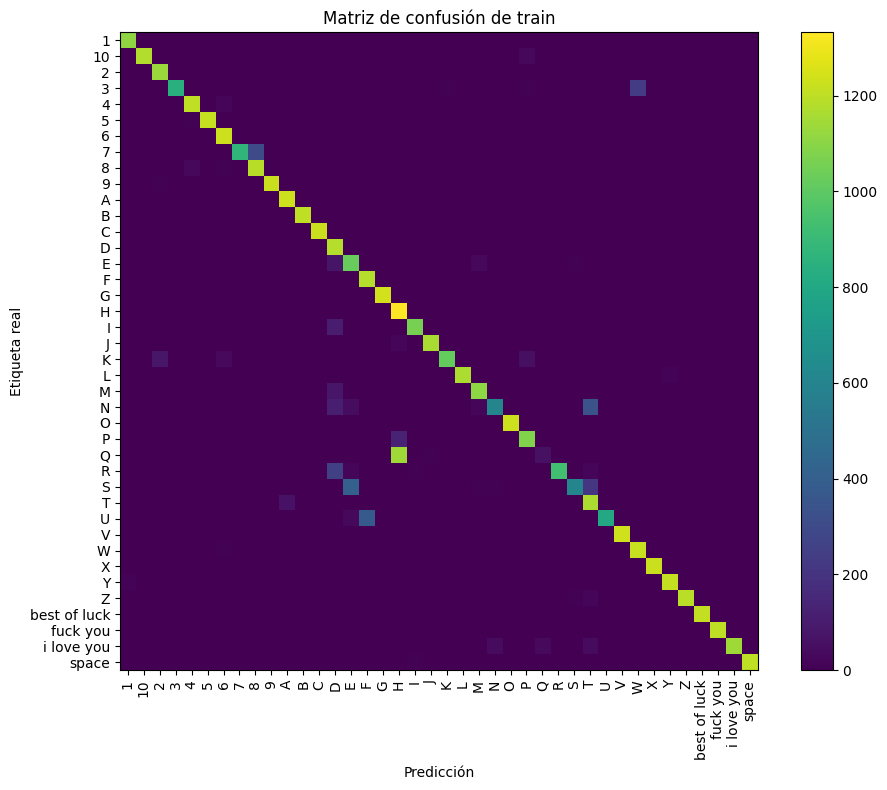

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# ================== 1. Recolectar y_true e y_pred ==================

y_true = []
y_pred = []

for batch_images, batch_labels in train_ds:
    probs = model.predict(batch_images, verbose=0)
    y_true.extend(batch_labels.numpy())
    y_pred.extend(np.argmax(probs, axis=1))

y_true = np.array(y_true)
y_pred = np.array(y_pred)

# ================== 2. Matriz de confusión ==================

num_classes = len(class_names)

cm = tf.math.confusion_matrix(
    y_true, y_pred, num_classes=num_classes
).numpy()

# ================== 3. Métricas por clase ==================

precision = np.zeros(num_classes)
recall = np.zeros(num_classes)
f1 = np.zeros(num_classes)
support = cm.sum(axis=1)  # nº de ejemplos por clase

for i in range(num_classes):
    tp = cm[i, i]
    fp = cm[:, i].sum() - tp
    fn = cm[i, :].sum() - tp

    precision[i] = tp / (tp + fp) if (tp + fp) > 0 else 0.0
    recall[i]    = tp / (tp + fn) if (tp + fn) > 0 else 0.0
    f1[i]        = (
        2 * precision[i] * recall[i] / (precision[i] + recall[i])
        if (precision[i] + recall[i]) > 0
        else 0.0
    )

macro_f1 = f1.mean()
weighted_f1 = (f1 * support / support.sum()).sum()

print("=== Métricas por clase ===")
print(f"{'Clase':15s} {'Soporte':>7s} {'Precisión':>10s} {'Recall':>10s} {'F1':>10s}")
for name, sup, p, r, f in zip(class_names, support, precision, recall, f1):
    print(f"{name:15s} {int(sup):7d} {p:10.3f} {r:10.3f} {f:10.3f}")

print("\nF1 macro:    {:.3f}".format(macro_f1))
print("F1 weighted: {:.3f}".format(weighted_f1))

# ================== 4. Matriz de confusión visual ==================

fig, ax = plt.subplots(figsize=(10, 8))
im = ax.imshow(cm, interpolation="nearest")
plt.colorbar(im, ax=ax)

ax.set_xticks(range(num_classes))
ax.set_yticks(range(num_classes))
ax.set_xticklabels(class_names, rotation=90)
ax.set_yticklabels(class_names)
ax.set_xlabel("Predicción")
ax.set_ylabel("Etiqueta real")
ax.set_title("Matriz de confusión de train")
plt.tight_layout()
plt.show()

# ================== OPCIONAL: F1 con sklearn (COMENTADO) ==================
# Si en otro entorno tienes sklearn instalado sin conflictos, puedes usar:
#
# from sklearn.metrics import classification_report, confusion_matrix, f1_score
# print(classification_report(y_true, y_pred, target_names=class_names, digits=3))
# f1_macro_sklearn = f1_score(y_true, y_pred, average="macro")
# f1_weighted_sklearn = f1_score(y_true, y_pred, average="weighted")
# print(f"F1 macro (sklearn):    {f1_macro_sklearn:.3f}")
# print(f"F1 weighted (sklearn): {f1_weighted_sklearn:.3f}")
# ==================================================================


# ***Guardado del Modelo Entrenado y sus Etiquetas***

In [ ]:
label_path = MODEL_DIR / LABELS_FILE
with label_path.open("w", encoding="utf-8") as fh:
    json.dump({"class_names": class_names}, fh, indent=2)
model.save(MODEL_DIR / MODEL_NAME)



print(f"Modelo guardado en: {MODEL_DIR / MODEL_NAME}")
print(f"Etiquetas guardadas en: {label_path}")

Modelo guardado en: models/asl_sign_classifier.keras
Etiquetas guardadas en: models/asl_sign_labels.json


In [ ]:
import os, base64
from IPython.display import HTML

def download_link(filepath):
    filename = os.path.basename(filepath)
    with open(filepath, "rb") as f:
        data = f.read()
    b64 = base64.b64encode(data).decode()
    return HTML(
        f'<a download="{filename}" '
        f'href="data:application/octet-stream;base64,{b64}">'
        f'Descargar {filename}</a>'
    )

# Ejemplo para tu modelo y tus etiquetas:
download_link("models/asl_sign_classifier.keras")


In [ ]:
download_link("models/asl_sign_labels.json")


# ***Traducción en Tiempo Real con Webcam***

In [ ]:
import cv2

def load_labels(path: Path):
    with path.open("r", encoding="utf-8") as fh:
        return json.load(fh)["class_names"]


def pad_to_square(image: np.ndarray) -> np.ndarray:
    height, width = image.shape
    size = max(height, width)
    padded = np.full((size, size), 255, dtype=np.uint8)
    y0 = (size - height) // 2
    x0 = (size - width) // 2
    padded[y0 : y0 + height, x0 : x0 + width] = image
    return padded


def preprocess_frame(frame: np.ndarray):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    _, thresh = cv2.threshold(
        blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
    )

    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None, 255 - thresh

    largest = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest)
    padding = int(0.2 * max(w, h))
    x0 = max(x - padding, 0)
    y0 = max(y - padding, 0)
    x1 = min(x + w + padding, frame.shape[1])
    y1 = min(y + h + padding, frame.shape[0])

    masked = 255 - thresh
    cropped = masked[y0:y1, x0:x1]
    squared = pad_to_square(cropped)
    resized = cv2.resize(squared, IMAGE_SIZE, interpolation=cv2.INTER_AREA)
    tensor = resized.astype("float32") / 255.0
    tensor = tensor.reshape(1, IMAGE_SIZE[0], IMAGE_SIZE[1], 1)
    return tensor, resized


def run_camera(model_path: Path, labels_path: Path, camera_index: int = 0):
    model = tf.keras.models.load_model(model_path)
    class_names = load_labels(labels_path)
    capture = cv2.VideoCapture(camera_index)

    if not capture.isOpened():
        raise RuntimeError(
            f"No se pudo abrir la webcam en el indice {camera_index}."
        )

    print("Presiona 'q' para cerrar la ventana.")
    while True:
        grabbed, frame = capture.read()
        if not grabbed:
            print("No fue posible leer un frame de la camara.")
            break

        processed, preview = preprocess_frame(frame)
        if processed is not None:
            probs = model.predict(processed, verbose=0)[0]
            idx = int(np.argmax(probs))
            confidence = float(probs[idx])
            text = f"{class_names[idx]} ({confidence*100:.1f}%)"
        else:
            text = "No se detecta mano"

        cv2.putText(
            frame,
            text,
            (10, 30),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.9,
            (0, 255, 0),
            2,
        )

        if processed is not None:
            cv2.imshow("Mascara normalizada", preview)
        cv2.imshow("ASL Translator", frame)

        if cv2.waitKey(1) & 0xFF == ord("q"):
            break

    capture.release()
    cv2.destroyAllWindows()

In [ ]:
# run_camera(MODEL_DIR / MODEL_NAME, MODEL_DIR / LABELS_FILE, camera_index=0)
# Ejecuta esta celda solo cuando tengas una webcam disponible y permisos de cámara.

# ***Preprocesamiento Común para Inferencia y Evaluación***

In [ ]:
import cv2
import numpy as np


def pad_to_square(image: np.ndarray) -> np.ndarray:
    height, width = image.shape
    size = max(height, width)
    padded = np.full((size, size), 255, dtype=np.uint8)
    y0 = (size - height) // 2
    x0 = (size - width) // 2
    padded[y0 : y0 + height, x0 : x0 + width] = image
    return padded


def preprocess_frame(frame: np.ndarray):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    _, thresh = cv2.threshold(
        blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
    )

    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None, 255 - thresh

    largest = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest)
    padding = int(0.2 * max(w, h))
    x0 = max(x - padding, 0)
    y0 = max(y - padding, 0)
    x1 = min(x + w + padding, frame.shape[1])
    y1 = min(y + h + padding, frame.shape[0])

    masked = 255 - thresh
    cropped = masked[y0:y1, x0:x1]
    squared = pad_to_square(cropped)
    resized = cv2.resize(squared, IMAGE_SIZE, interpolation=cv2.INTER_AREA)
    tensor = resized.astype("float32") / 255.0
    tensor = tensor.reshape(1, IMAGE_SIZE[0], IMAGE_SIZE[1], 1)
    return tensor, resized

# ***Validación Rápida con Imagen Individual***

In [ ]:
from PIL import Image

def evaluate_single_image(path: Path):
    frame = cv2.imread(str(path))
    if frame is None:
        raise FileNotFoundError(f"No se pudo abrir {path}")
    processed, preview = preprocess_frame(frame)
    if processed is None:
        raise RuntimeError("No se detectó mano en la imagen.")

    probs = model.predict(processed, verbose=0)[0]
    idx = int(np.argmax(probs))
    print(f"Predicción: {class_names[idx]} - {probs[idx]*100:.2f}%")

    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title('Frame original')
    plt.axis('off')
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.subplot(1,2,2)
    plt.title('Mascara normalizada (64x64)')
    plt.axis('off')
    plt.imshow(preview, cmap='gray')
    plt.show()

# Uso:
# evaluate_single_image(Path('/ruta/a/una/imagen.png'))